In [135]:
import pandas as pd
import numpy as np

import string
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from sklearn.feature_extraction.text import CountVectorizer

import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.decomposition import PCA
from sklearn.compose import ColumnTransformer

import itertools

from sklearn.ensemble import RandomForestClassifier

from sklearn.metrics import classification_report, confusion_matrix

# Ensure NLTK components are available
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('punkt_tab')
nltk.download('wordnet')
nltk.download('omw-1.4')

[nltk_data] Downloading package stopwords to
[nltk_data]     /home/homeworldcata/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     /home/homeworldcata/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to
[nltk_data]     /home/homeworldcata/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     /home/homeworldcata/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     /home/homeworldcata/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


True

## Load and preprocess for catagorical features

In [101]:
dataset = pd.read_csv('data/fake_news.csv')

Let's discover the data a bit before preprocessing

In [102]:
dataset.describe()

,label
count,2500.00000
mean,0.47720
std,0.49958
min,0.00000
25%,0.00000
50%,0.00000
75%,1.00000
max,1.00000


In [103]:
print(dataset.shape)
dataset.head()

(2500, 5)


,title,text,subject,date,label
0,WOW! LOU DOBBS BLASTS #FakePresident OBAMA: “S...,Lou Dobbs went off on #FakePresident Barack Ob...,politics,2017-07-11,0
1,President WATCH: FUNNIEST Done ‘Couch Commande...,For his final White House Correspondent s Dinn...,News,2016-04-30,0
2,RELIGION OF PROGRESSIVISM: Meet Obama’s NEW Tr...,The religion of Progressivism is working overt...,politics,2016-05-17,0
3,Breitbart Caught Praising Melania For Exact T...,In a stunning example of just how morally bank...,News,2017-05-21,0
4,HOST SICKENING! MOCKS Jeff Grandchildren Senat...,,politics,2017-01-10,0


Delta percent diffrence: %4.56


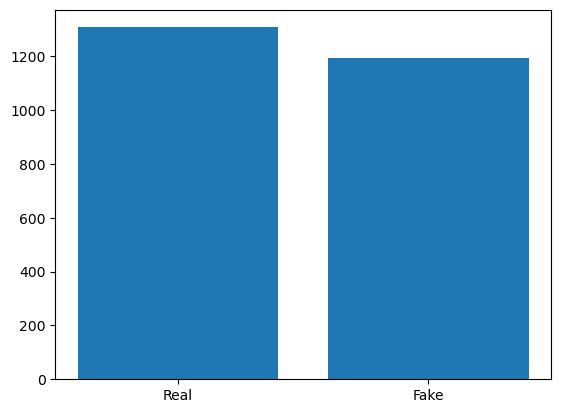

In [104]:
real_count = (dataset['label'] == 0).sum()
fake_count = (dataset['label'] == 1).sum()

print("Delta percent diffrence: %{0:2.2f}".format((abs(real_count - fake_count)/dataset.shape[0]) * 100))

plt.bar(['Real', 'Fake'], [real_count, fake_count])
plt.show()

I consider the diffrence to be negligible so we won't need to imputate 

In [105]:
dataset.isna().sum()

title      0
text       0
subject    0
date       1
label      0
dtype: int64

In [106]:
dataset = dataset.dropna()

subjects = dataset[['subject']]
subject_encoder = OneHotEncoder(sparse_output= False)
subjects = subject_encoder.fit_transform(subjects)
subjects = pd.DataFrame(subjects, columns=subject_encoder.get_feature_names_out())
dataset = pd.concat([dataset.drop('subject', axis=1), subjects], axis=1)


We'll now encode the date

In [107]:
date_split = dataset['date'].str.split('-', expand = True)
year = pd.to_numeric(date_split[0], downcast='signed')
month = pd.to_numeric(date_split[1], downcast='signed')
day = year = pd.to_numeric(date_split[2], downcast='signed')
dataset['year'] = year
dataset['month'] = month
dataset['day'] = day
dataset = dataset.drop('date', axis=1)
dataset = dataset.dropna()


## Lematizing and vectorizing for bag-o-words

Hippty hoppity your code is now my property

In [108]:
lemmatizer = WordNetLemmatizer()
stop_words = set(stopwords.words('english'))
punct_table = str.maketrans('', '', string.punctuation)

def preprocess(text):
    if not text:
        print("Uh that's wrong sooooo blank string")
        print(text)
        text = ""
    tokens = word_tokenize(text)
    print(f"Tokens before preprocessing: {tokens}")

    tokens = [t.lower().translate(punct_table) for t in tokens if t.isalnum()]
    print(f"Tokens after removing punctuation and lowercasing: {tokens}")

    tokens = [t for t in tokens if t not in stop_words]
    print(f"Tokens after removing stopwords: {tokens}")

    tokens = [lemmatizer.lemmatize(t) for t in tokens]
    print(f"Tokens after lemmatization: {tokens}")
    
    return ' '.join(tokens)

In [109]:
dataset['CleanedTitle'] = dataset['title'].apply(preprocess)
dataset['CleanedText'] = dataset['text'].apply(preprocess)
dataset.head()

Tokens before preprocessing: ['WOW', '!', 'LOU', 'DOBBS', 'BLASTS', '#', 'FakePresident', 'OBAMA', ':', '“', 'Spent', '8', 'Years', 'Undermining', 'Core', 'American', 'Values', '”', '…', 'Now', 'Doing', 'His', 'Best', 'To', '“', 'Undercut', 'President', 'Trump', '”', 'By', 'Pretending', 'To', 'Still', 'Be', 'President', '[', 'VIDEO', ']']
Tokens after removing punctuation and lowercasing: ['wow', 'lou', 'dobbs', 'blasts', 'fakepresident', 'obama', 'spent', '8', 'years', 'undermining', 'core', 'american', 'values', 'now', 'doing', 'his', 'best', 'to', 'undercut', 'president', 'trump', 'by', 'pretending', 'to', 'still', 'be', 'president', 'video']
Tokens after removing stopwords: ['wow', 'lou', 'dobbs', 'blasts', 'fakepresident', 'obama', 'spent', '8', 'years', 'undermining', 'core', 'american', 'values', 'best', 'undercut', 'president', 'trump', 'pretending', 'still', 'president', 'video']
Tokens after lemmatization: ['wow', 'lou', 'dobbs', 'blast', 'fakepresident', 'obama', 'spent', '8

,title,text,label,subject_Government News,subject_Middle-east,subject_News,subject_US_News,subject_left-news,subject_politics,subject_politicsNews,subject_worldnews,year,month,day,CleanedTitle,CleanedText
0,WOW! LOU DOBBS BLASTS #FakePresident OBAMA: “S...,Lou Dobbs went off on #FakePresident Barack Ob...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,11.0,7.0,11.0,wow lou dobbs blast fakepresident obama spent ...,lou dobbs went fakepresident barack obama dobb...
1,President WATCH: FUNNIEST Done ‘Couch Commande...,For his final White House Correspondent s Dinn...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,30.0,4.0,30.0,president watch funniest done couch commander ...,final white house correspondent dinner white h...
2,RELIGION OF PROGRESSIVISM: Meet Obama’s NEW Tr...,The religion of Progressivism is working overt...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,17.0,5.0,17.0,religion progressivism meet obama new transgen...,religion progressivism working overtime erase ...
3,Breitbart Caught Praising Melania For Exact T...,In a stunning example of just how morally bank...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,21.0,5.0,21.0,breitbart caught praising melania exact thing ...,stunning example morally bankrupt medium becom...
4,HOST SICKENING! MOCKS Jeff Grandchildren Senat...,,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,10.0,1.0,10.0,host sickening mock jeff grandchild senator mt...,


In [110]:
vectorizer_title = CountVectorizer()
vectorizer_text = CountVectorizer()
title_bow = vectorizer_title.fit_transform(dataset['CleanedTitle'])
text_bow = vectorizer_text.fit_transform(dataset['CleanedText'])
title_bow = pd.DataFrame(title_bow.toarray(), columns=vectorizer_title.get_feature_names_out())
text_bow = pd.DataFrame(text_bow.toarray(), columns=vectorizer_text.get_feature_names_out())

title_bow = title_bow.add_suffix('_title')
text_bow = text_bow.add_suffix('_text')


title_bow.head()

,10_title,100_title,100k_title,101_title,108_title,10th_title,11_title,114_title,117_title,12_title,...,zarrab_title,zealand_title,zero_title,zika_title,zimbabwe_title,zimmerman_title,zing_title,zombie_title,zuckerberg_title,zurich_title
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


Let's see the word frequency

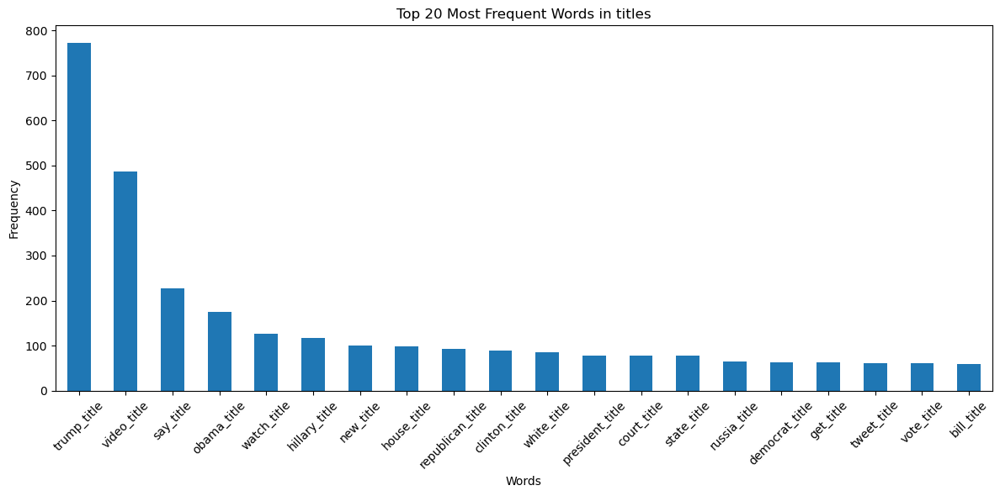

In [111]:
word_freq = title_bow.sum().sort_values(ascending=False)

# Select top 20 words
top_n = 20
top_words = word_freq.head(top_n)

# Plot
plt.figure(figsize=(12, 6))
top_words.plot(kind='bar')
plt.title(f"Top {top_n} Most Frequent Words in titles")
plt.xlabel("Words")
plt.ylabel("Frequency")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

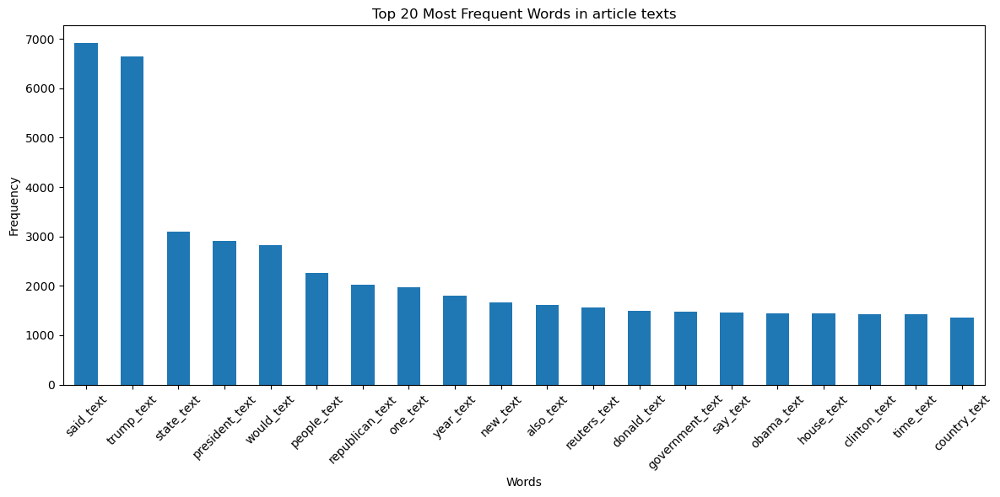

In [112]:
word_freq = text_bow.sum().sort_values(ascending=False)

# Select top 20 words
top_n = 20
top_words = word_freq.head(top_n)

# Plot
plt.figure(figsize=(12, 6))
top_words.plot(kind='bar')
plt.title(f"Top {top_n} Most Frequent Words in article texts")
plt.xlabel("Words")
plt.ylabel("Frequency")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# THE MERGE

In [113]:
dataset = pd.concat([dataset, title_bow, text_bow], axis = 1)
dataset = dataset.drop(['CleanedTitle', 'CleanedText', 'title', 'text'], axis=1)
dataset = dataset.dropna()

In [114]:
y_raw = dataset['label']
x_raw = dataset.drop(['label'], axis=1)

X_train, X_test, y_train, y_test = train_test_split(x_raw, y_raw, test_size=0.2)
X_train.head()

,subject_Government News,subject_Middle-east,subject_News,subject_US_News,subject_left-news,subject_politics,subject_politicsNews,subject_worldnews,year,month,...,zullo_text,zulu_text,zuma_text,zunaid_text,zunes_text,zuo_text,zurich_text,zuwara_text,zwak_text,zweli_text
928,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,25.0,5.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2209,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,5.0,2.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
823,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,13.0,3.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
920,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,5.0,2.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2092,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,21.0,10.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [115]:
X_train.isna().sum()

subject_Government News    0
subject_Middle-east        0
subject_News               0
subject_US_News            0
subject_left-news          0
                          ..
zuo_text                   0
zurich_text                0
zuwara_text                0
zwak_text                  0
zweli_text                 0
Length: 34076, dtype: int64

# Modifing the data in ways that "train" the model

## Dimension reduction and standardization

<p style="color:red">WARINING LONG RUNTIME CELL</p> took me 1m and 38s to run on AMD Ryzen 9 5900HX with 8 physical cores

In [116]:
title_PCA = PCA(n_components = 0.95)
title_data_transformed = title_PCA.fit_transform(X_train[title_bow.columns])
text_PCA = PCA(n_components = 0.95)
text_data_transformed = text_PCA.fit_transform(X_train[text_bow.columns])

title_data_transformed_test = title_PCA.transform(X_test[title_bow.columns])
text_data_transformed_test = text_PCA.transform(X_test[text_bow.columns])

In [117]:
title_data_transformed = pd.DataFrame(title_data_transformed, columns = title_PCA.get_feature_names_out())
title_data_transformed = title_data_transformed.add_suffix('_title')
title_data_transformed.index = X_train.index

title_data_transformed_test = pd.DataFrame(title_data_transformed_test, columns = title_PCA.get_feature_names_out())
title_data_transformed_test = title_data_transformed_test.add_suffix('_title')
title_data_transformed_test.index = X_test.index

In [118]:
print(X_train.shape, title_data_transformed.shape)

(1997, 34076) (1997, 1372)


In [119]:
text_data_transformed = pd.DataFrame(text_data_transformed, columns = text_PCA.get_feature_names_out())
text_data_transformed = text_data_transformed.add_suffix('_text')
text_data_transformed.index = X_train.index

text_data_transformed_test = pd.DataFrame(text_data_transformed_test, columns = text_PCA.get_feature_names_out())
text_data_transformed_test = text_data_transformed_test.add_suffix('_text')
text_data_transformed_test.index = X_test.index

In [120]:
title_data_transformed.head()

,pca0_title,pca1_title,pca2_title,pca3_title,pca4_title,pca5_title,pca6_title,pca7_title,pca8_title,pca9_title,...,pca1362_title,pca1363_title,pca1364_title,pca1365_title,pca1366_title,pca1367_title,pca1368_title,pca1369_title,pca1370_title,pca1371_title
928,0.717317,-0.249515,-0.163521,-0.189556,-0.189627,0.417242,0.066221,-0.426853,0.736655,-0.022729,...,-0.000192,0.000502,-0.019190,0.005059,-0.059406,-0.035303,-0.005337,-0.034185,0.089950,0.043835
2209,-0.346028,-0.207376,-0.124173,-0.066951,0.881543,0.044820,0.192152,-0.497450,-0.244177,0.522299,...,-0.019098,-0.015803,0.014336,-0.049000,0.027308,0.006951,-0.000837,-0.000702,0.025551,0.048460
823,-0.255808,-0.061241,-0.053145,-0.196005,-0.194719,-0.291655,0.873018,0.123035,-0.056357,0.085099,...,-0.015230,0.025601,0.012900,0.023856,0.012969,-0.011316,-0.013975,-0.011606,0.028858,-0.032669
920,-0.264282,-0.134592,-0.112187,-0.165118,-0.062990,-0.006073,-0.036722,0.074593,-0.179011,-0.110084,...,-0.011640,0.054682,0.061281,-0.042446,-0.000363,0.005372,0.023068,-0.002971,-0.008771,-0.051549
2092,-0.337705,-0.145596,-0.061818,-0.128835,-0.098642,-0.052186,0.015618,-0.036194,0.064684,-0.066321,...,-0.017140,0.015757,0.085341,-0.004250,-0.030519,-0.012516,0.003645,-0.039902,0.039016,0.022454


Merge PCA back in

In [121]:
X_train = X_train.drop(title_bow.columns, axis = 1)
X_train = X_train.drop(text_bow.columns, axis = 1)

X_test = X_test.drop(title_bow.columns, axis = 1)
X_test = X_test.drop(text_bow.columns, axis = 1)

X_train = pd.concat([X_train, title_data_transformed, text_data_transformed], axis = 1)
X_test = pd.concat([X_test, title_data_transformed_test, text_data_transformed_test], axis = 1)

X_train.head()

,subject_Government News,subject_Middle-east,subject_News,subject_US_News,subject_left-news,subject_politics,subject_politicsNews,subject_worldnews,year,month,...,pca1056_text,pca1057_text,pca1058_text,pca1059_text,pca1060_text,pca1061_text,pca1062_text,pca1063_text,pca1064_text,pca1065_text
928,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,25.0,5.0,...,-0.528814,0.075754,-0.516752,-0.236597,-0.260118,-0.292549,-0.880564,-0.571051,-0.487006,-0.564064
2209,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,5.0,2.0,...,0.083853,0.089486,0.110925,-0.026596,0.113875,-0.095212,-0.024116,-0.072339,-0.009244,0.002874
823,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,13.0,3.0,...,-0.263660,-0.351574,-0.038239,-0.184146,-0.014114,-0.078164,0.025188,-0.073991,0.090373,0.332582
920,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,5.0,2.0,...,-0.155920,0.257574,-0.035968,1.334614,-0.374393,0.134138,-0.023303,0.270122,0.042160,0.127380
2092,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,21.0,10.0,...,0.357150,-0.119162,-0.065818,0.156125,0.714025,0.182173,-0.211190,0.691316,-0.299599,0.409899


Now standardize the data

In [122]:
X_train.isna().sum()

subject_Government News    0
subject_Middle-east        0
subject_News               0
subject_US_News            0
subject_left-news          0
                          ..
pca1061_text               0
pca1062_text               0
pca1063_text               0
pca1064_text               0
pca1065_text               0
Length: 2449, dtype: int64

In [123]:
scaler = StandardScaler()
scaled_data = pd.DataFrame(scaler.fit_transform(X_train), columns = X_train.columns)
scaled_data.index = X_train.index
X_train = scaled_data

scaled_data_test = pd.DataFrame(scaler.transform(X_test), columns = X_test.columns)
scaled_data_test.index = X_test.index
X_test = scaled_data_test
X_test.head()

X_train.head()

,subject_Government News,subject_Middle-east,subject_News,subject_US_News,subject_left-news,subject_politics,subject_politicsNews,subject_worldnews,year,month,...,pca1056_text,pca1057_text,pca1058_text,pca1059_text,pca1060_text,pca1061_text,pca1062_text,pca1063_text,pca1064_text,pca1065_text
928,-0.20026,-0.125571,2.046219,-0.127613,-0.320477,-0.442502,-0.562507,-0.561736,1.071985,-0.616781,...,-1.940598,0.278081,-1.899109,-0.871601,-0.958780,-1.079987,-3.253340,-2.110208,-1.801213,-2.088735
2209,-0.20026,-0.125571,-0.488706,-0.127613,-0.320477,-0.442502,1.777756,-0.561736,-1.193963,-1.468587,...,0.307718,0.328486,0.407661,-0.097976,0.419737,-0.351488,-0.089099,-0.267315,-0.034188,0.010644
823,-0.20026,-0.125571,2.046219,-0.127613,-0.320477,-0.442502,-0.562507,-0.561736,-0.287584,-1.184652,...,-0.967558,-1.290568,-0.140532,-0.678374,-0.052022,-0.288553,0.093061,-0.273420,0.334248,1.231556
920,-0.20026,-0.125571,2.046219,-0.127613,-0.320477,-0.442502,-0.562507,-0.561736,-1.193963,-1.468587,...,-0.572183,0.945511,-0.132184,4.916585,-1.379992,0.495191,-0.086094,0.998182,0.155929,0.471690
2092,-0.20026,-0.125571,-0.488706,-0.127613,-0.320477,-0.442502,-0.562507,1.780197,0.618796,0.802896,...,1.310637,-0.437424,-0.241887,0.575147,2.631860,0.672518,-0.780264,2.554624,-1.108079,1.517861


# Model training and precision

In [ ]:
model = RandomForestClassifier(max_depth=50)
model.fit(X_train, y_train)

RandomForestClassifier(max_depth=50)

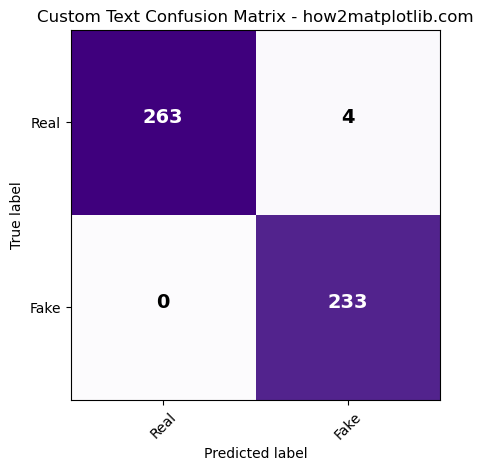

              precision    recall  f1-score   support

         0.0       1.00      0.99      0.99       267
         1.0       0.98      1.00      0.99       233

    accuracy                           0.99       500
   macro avg       0.99      0.99      0.99       500
weighted avg       0.99      0.99      0.99       500



In [139]:
y_predict = model.predict(X_test)

# Slightly modified from how2matplotlib
cm = confusion_matrix(y_test, y_predict)
plt.imshow(cm, cmap=plt.cm.Purples)
plt.xticks([0,1], ['Real', 'Fake'], rotation=45)
plt.yticks([0,1], ['Real', 'Fake'])

for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
    plt.text(j, i, format(cm[i, j], 'd'),
             horizontalalignment="center",
             color="white" if cm[i, j] > 0.5 * cm.max() else "black",
             fontweight='bold', fontsize=14)

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.title('Custom Text Confusion Matrix - how2matplotlib.com')
plt.show()
print(classification_report(y_test, y_predict))

WOO BABY THAT'S WHAT I'M TALKING ABOUT

<!-- stand_scaler = StandardScaler()
X_train = stand_ -->